In [1]:
%load_ext autoreload
%autoreload 2
from generators import DiagBooleanMatrix, ArbiBooleanMatrix
import numpy as np

[I] m            : 2000
[I] n            : 1000
[I] k            : 5
[I] overlap_flag : False
[I] size_range   : [0.25 0.75 0.25 1.  ]
[I] seed         : 2023
[I] noise        : [0.4  0.02]
[I] seed         : 1024
[I] Using RandomState.


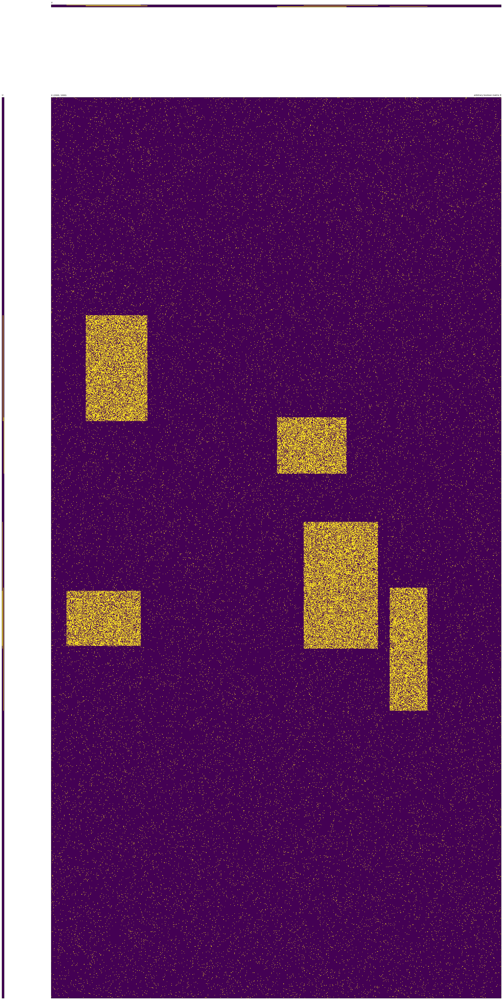

[I] m            : 200
[I] n            : 1000
[I] k            : 5
[I] overlap      : [0.2 0.1 0.2 0.1]
[I] seed         : 1997
[I] seed         : 2023
[I] Using RandomState.
[I] Using RandomState.
[I] noise        : [0.3 0.1]
[I] seed         : 1024
[I] Using RandomState.


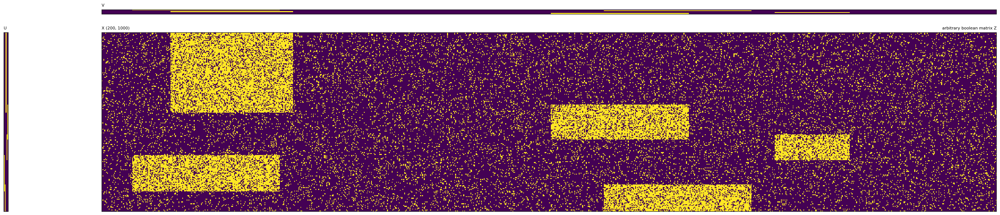

In [2]:
# generate arbitrary Boolean matrix (X)

n_row=2000
n_col=1000
k=5
overlap_flag=True
noise=[0.4, 0.02]
size_range=[0.25, 0.75, 0.25, 1.0]

X = ArbiBooleanMatrix(m=n_row, n=n_col, k=k, overlap_flag=False, size_range=size_range)
X.generate(seed=2023) # if no seed assigned, use time instead
X.add_noise(noise=noise, seed=1024)
X.show_matrix(title='arbitrary boolean matrix X')

# generate arbitrary Boolean matrix (Z)

n_row=200
n_col=1000
k=5
overlap=[0.2, 0.1, 0.2, 0.1]
noise=[0.3, 0.1]

Z = DiagBooleanMatrix(m=n_row, n=n_col, k=k, overlap=overlap)
Z.generate(seed=1997)
Z.shuffle_factors(seed=2023)
Z.V = X.V # replace one factor
Z.boolean_matmul()
Z.add_noise(noise=noise, seed=1024)
Z.show_matrix(title="arbitrary boolean matrix Z")

In [3]:
from datasets import Dataset, GeneratedData
X_data = GeneratedData(bm=X, X_name='X', U_name='U', V_name='V')
# Z_data = GeneratedData(bm=Z, X_name='Z', U_name='W', V_name='V')
Z_data = GeneratedData(bm=Z, X_name='X', U_name='U', V_name='V')

# without splitting
X_dataset = Dataset()
X_dataset.load_data(X=X_data)

Z_dataset = Dataset()
Z_dataset.load_data(X=Z_data)

[I] k            : 5
[I] tau          : 0.2
[I] weights      : [0.7, 0.3]
[I] k            : 5
[I] tau          : 0.2
[I] weights      : [0.7, 0.3]
[I] display : True
[W] Missing validation set.


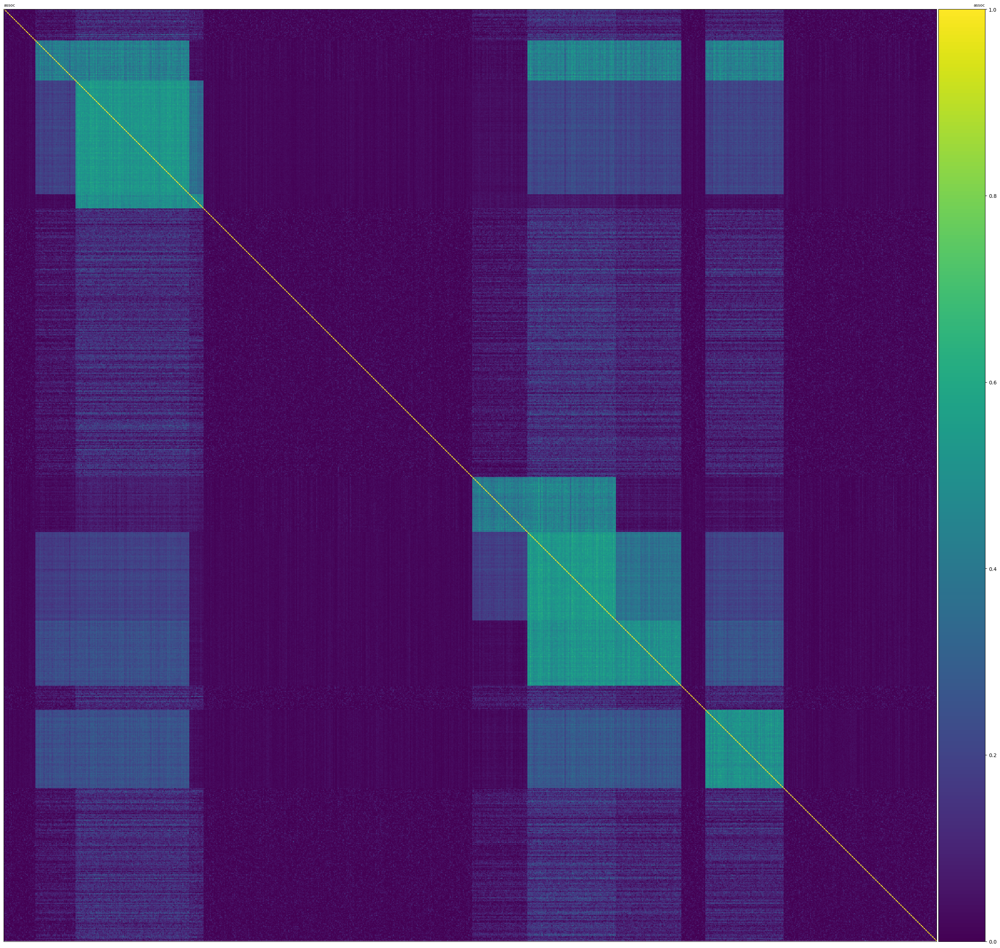

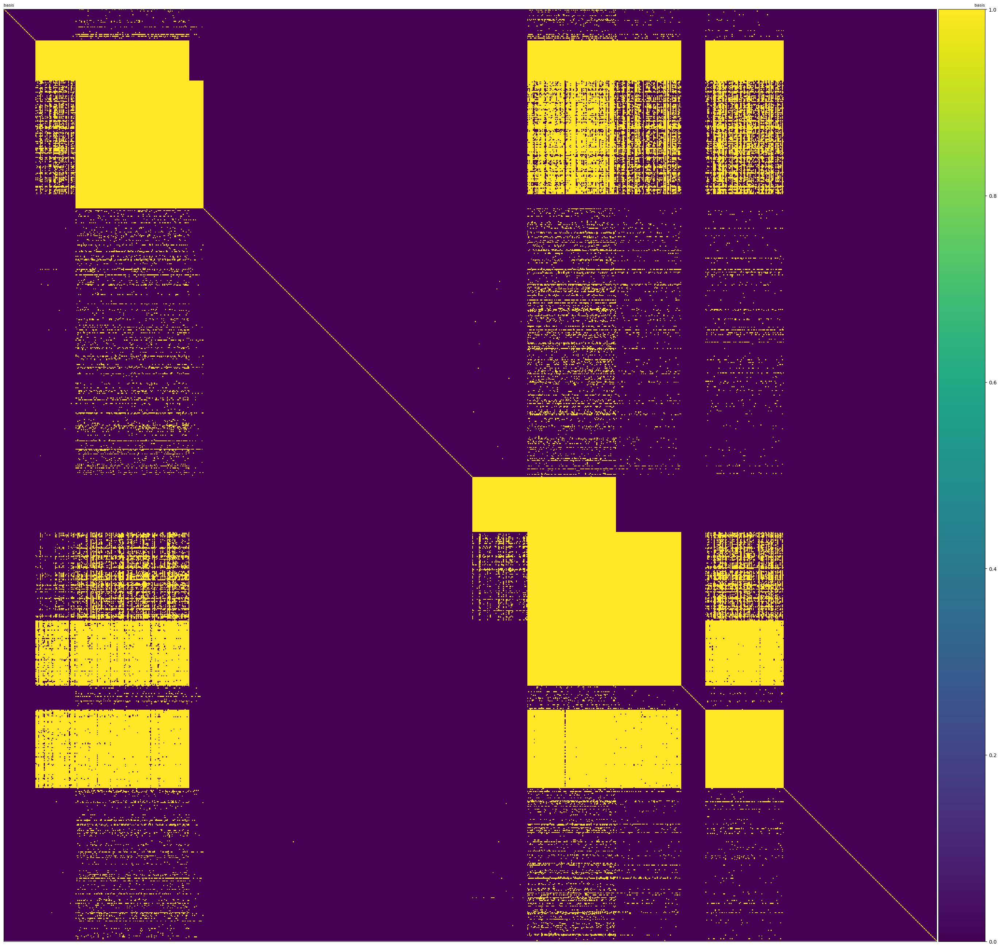

[I] display : False
[W] Missing validation set.


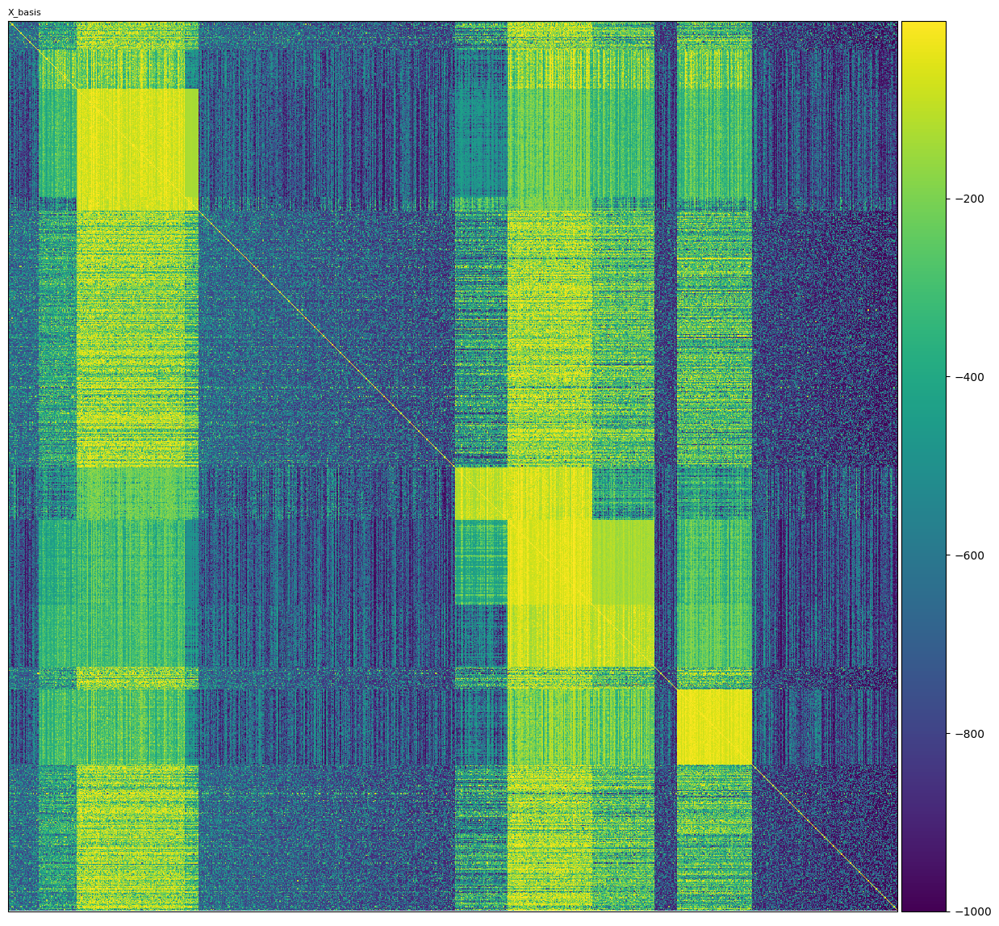

[I] display : True
[W] Missing validation set.


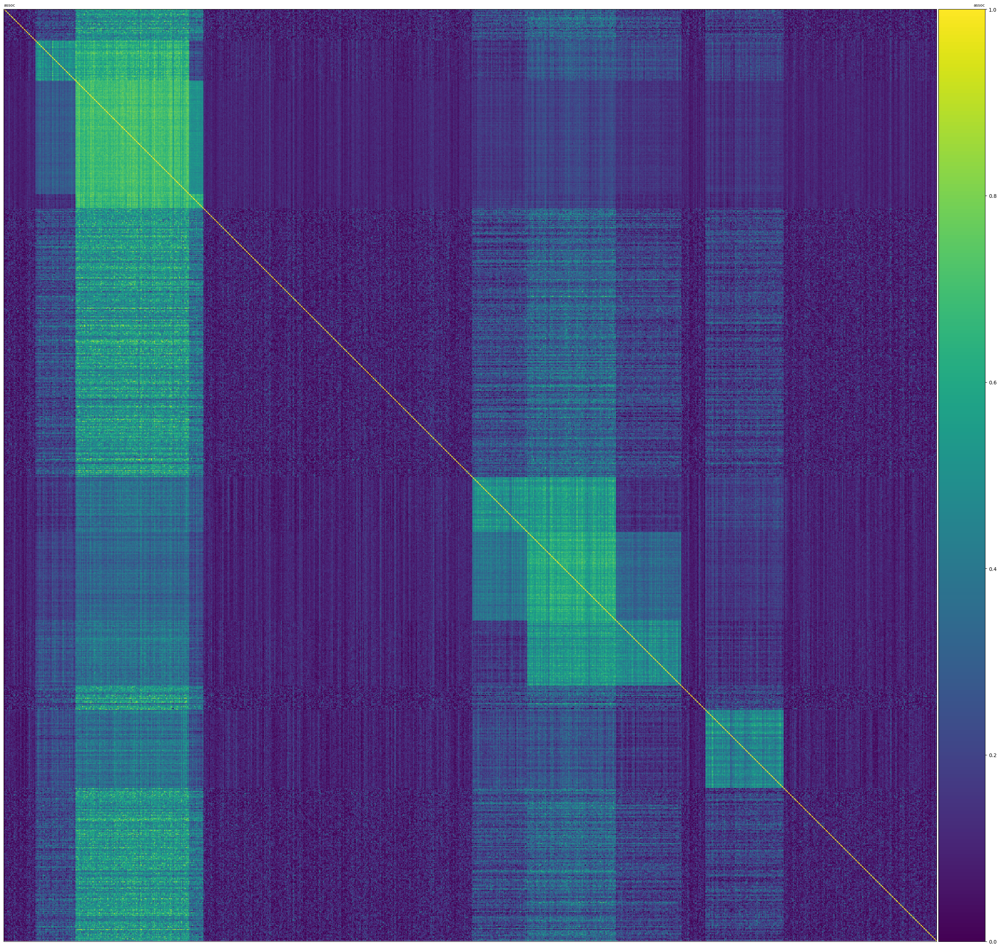

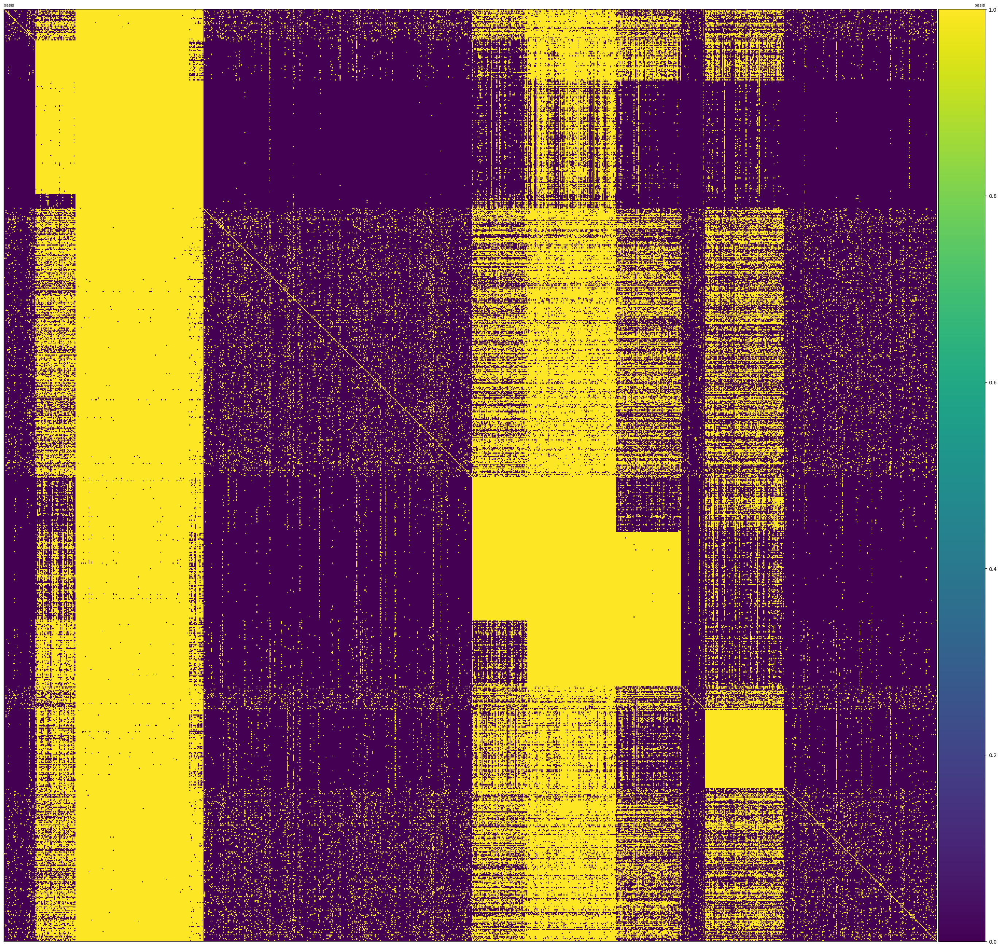

[I] display : False
[W] Missing validation set.


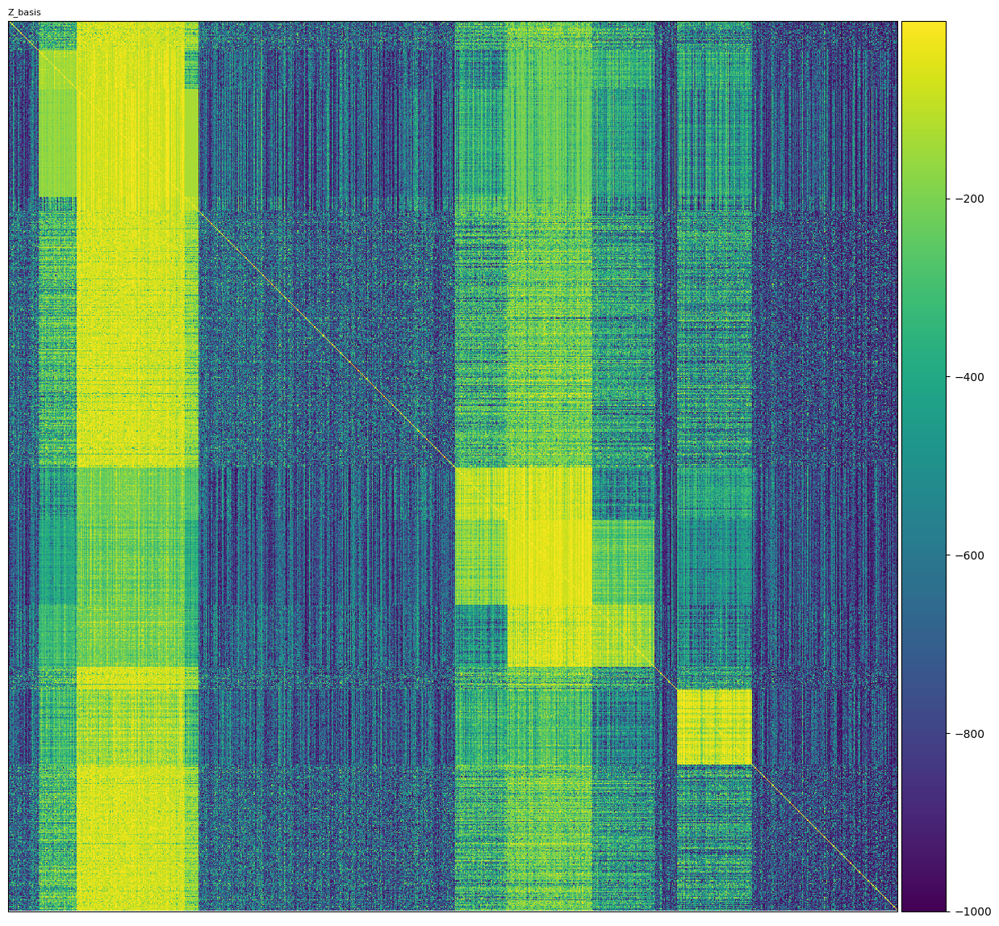

In [12]:
from models import Asso, AssoQuant
from utils import show_matrix, check_sparse

k = 5
tau = 0.20
w = [0.7, 0.3]

asso = Asso(k=k, tau=tau, w=w)
aq = AssoQuant(k=k, tau=tau, w=w)

asso._fit_prepare(train_set=X_dataset, display=True)
X_basis_asso = check_sparse(asso.basis, sparse=False)
# settings = [(X_basis, [0, 0], 'X_basis ASSO')]
# show_matrix(settings=settings, colorbar=True)

aq._fit_prepare(train_set=X_dataset, display=False)
X_basis = n_col - aq.basis
settings = [(X_basis, [0, 0], 'X_basis')]
show_matrix(settings=settings, colorbar=True)

#

asso._fit_prepare(train_set=Z_dataset, display=True)
Z_basis_asso = check_sparse(asso.basis, sparse=False)
# settings = [(Z_basis, [0, 0], 'Z_basis ASSO')]
# show_matrix(settings=settings, colorbar=True)

aq._fit_prepare(train_set=Z_dataset, display=False)
Z_basis = n_col - aq.basis
settings = [(Z_basis, [0, 0], 'Z_basis')]
show_matrix(settings=settings, colorbar=True)

In [ ]:
# for i in n_col:
#     best_row = np.zeros(n_col)
#     for j in n_col:
        


# settings = [(-Z_basis, [0, 0], 'Z_basis')]
# show_matrix(settings=settings, colorbar=True)

In [ ]:
# ds_train = Dataset()
# ds_train.load_data(X=X_data)
# ds_train.load_data(X=Z_data)
# ds_train.summarize()

In [5]:
# from datasets import Dataset, NetflixData, NetflixGenreData
# X_data = NetflixData(small=True)
# Z_data = NetflixGenreData(small=True)

# sum_u, sum_v = X_data.X.sum
# # idx_u = sum_u > 130
# # idx_v = sum_v > 200
# idx_u = sum_u > 40
# idx_v = sum_v > 60
# print(X_data.X.shape, sum(idx_u), sum(idx_v))

In [6]:
# # down-sampling by constraints

# X_data.sample(idx=idx_u, axis=0)
# print(X_data.X.shape)
# X_data.sample(idx=idx_v, axis=1)
# print(X_data.X.shape)
# Z_data.sample(idx=idx_v, axis=1)
# print(Z_data.X.shape)

In [7]:
# # down-sampling by random

# X_data.sample(n=1000, axis=0)
# print(X_data.X.shape)
# idx_v = X_data.sample(n=500, axis=1)
# print(X_data.X.shape)
# Z_data.sample(idx=idx_v, axis=1)
# print(Z_data.X.shape)

# k-fold cross-validation

[I] cross-validation, sampling positives
[I]   Re-using original config, seed will be ignored.
[I] getting cross-validation indices
[I]   current fold         : 1
[I]   current train size   : 78465
[I]   current val size     : 19617
[I] cross-validation, sampling negatives
[I]   Re-using original config, seed will be ignored.
[I] getting cross-validation indices
[I]   current fold         : 1
[I]   current train size   : 0
[I]   current val size     : 4904


c:\Users\hongtuonie\Anaconda3\envs\cornac\lib\site-packages\scipy\sparse\_index.py:103: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_intXint(row, col, x.flat[0])


[I] Mean num of Vs per U in X: 39.2
[I] Mean num of Us per V in X: 78.5
[I] Median num of Vs per U in X: 16.0
[I] Median num of Us per V in X: 35.0


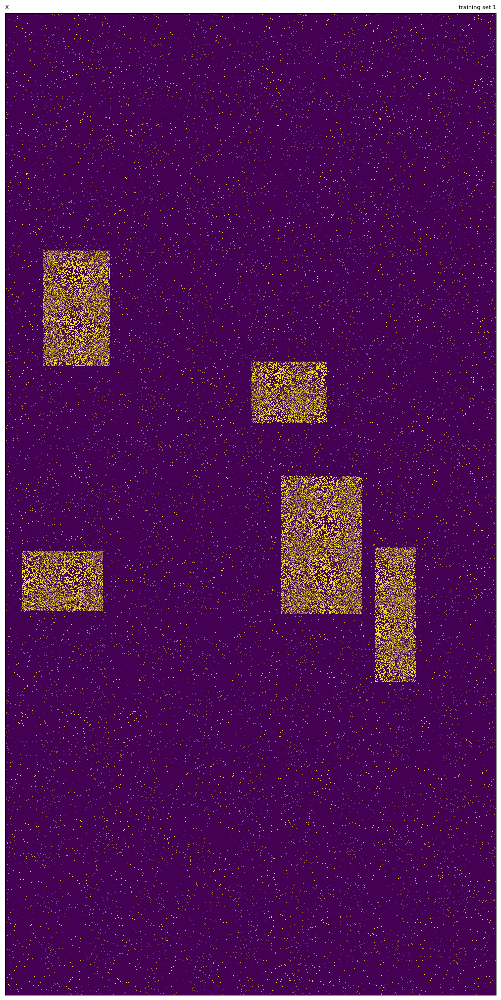

[I] Mean num of Vs per U in X: 9.8
[I] Mean num of Us per V in X: 19.6
[I] Median num of Vs per U in X: 5.0
[I] Median num of Us per V in X: 11.0


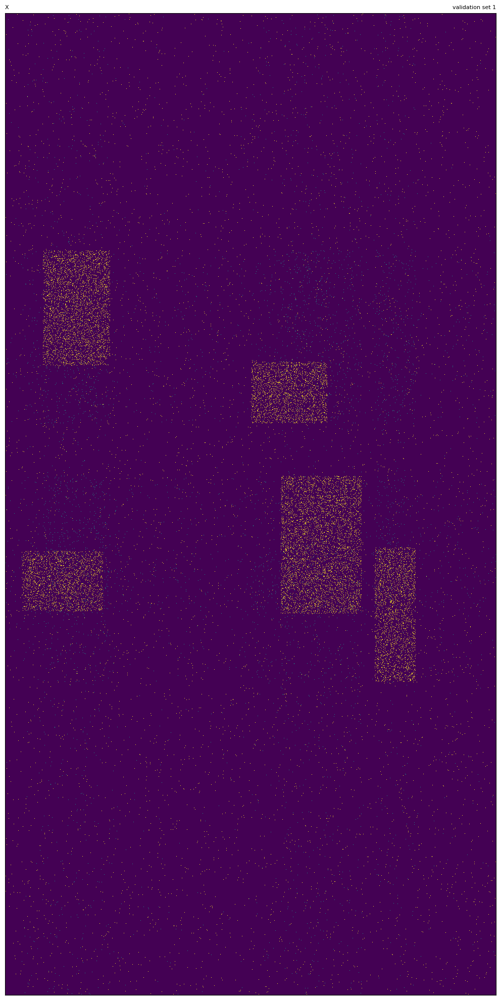

[I] Mean num of Vs per U in X: 12.3
[I] Mean num of Us per V in X: 24.5
[I] Median num of Vs per U in X: 6.0
[I] Median num of Us per V in X: 13.0


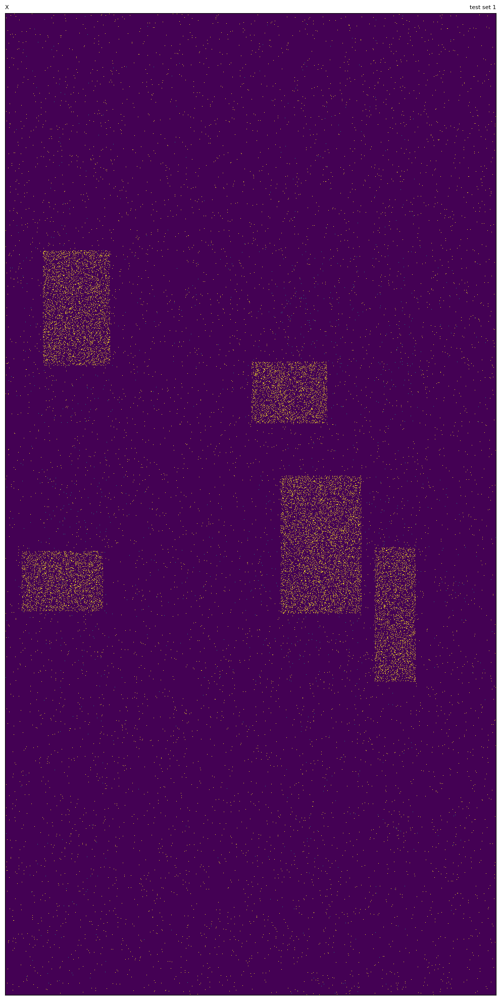

[I] k            : 5
[I] tau          : 0.2
[I] weights      : [0.6, 0.4]
[I] display : True
[I] tau          : 0.5
[I] weights      : [0.5, 0.5]
[W] Missing validation set.


c:\Users\hongtuonie\Anaconda3\envs\cornac\lib\site-packages\scipy\sparse\_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


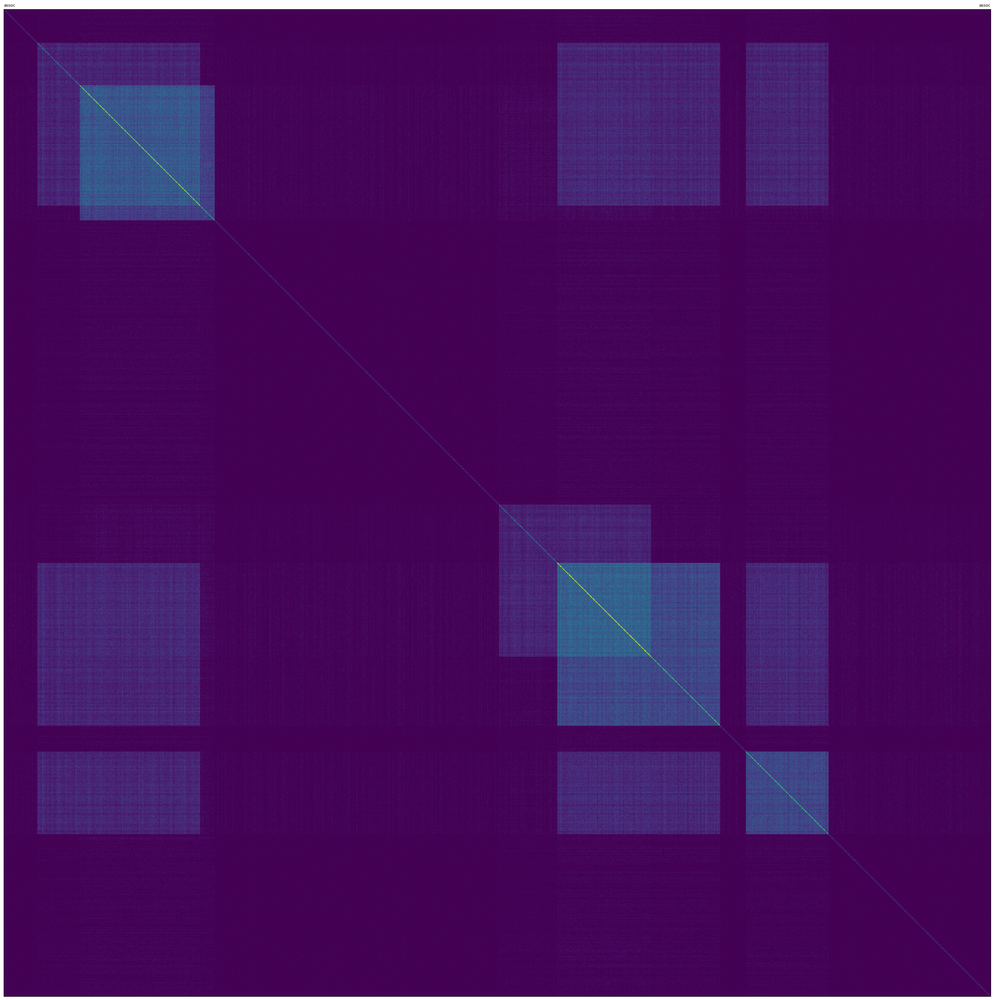

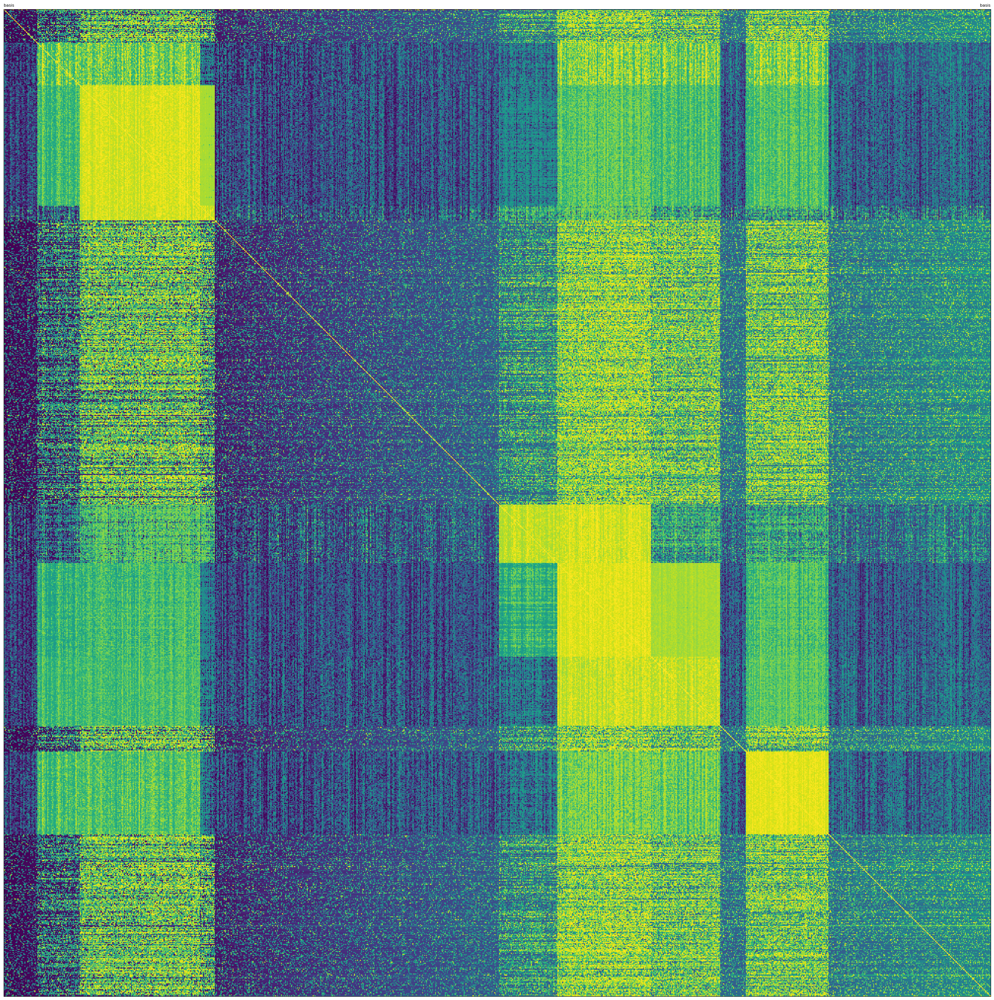

In [53]:
from models import AssoQuant

n_fold = 1

for i in range(n_fold):
    fold = i + 1

    X_data.cross_validation(test_size=0.2, n_folds=5, current_fold=fold, seed=1997)
    pos_train_val_size = X_data.pos_train_size + X_data.pos_val_size
    X_data.cv_negative_sample(n_folds=n_fold,
                              current_fold=fold,
                              train_val_size=int(0.05 * pos_train_val_size),
                              test_size=int(0.05 * X_data.pos_test_size), 
                              seed=6666, type='popularity')

    ds_train = Dataset()
    ds_train.load_data(X=X_data.train_data, U=X_data.U, V=X_data.V)

    ds_val = Dataset()
    ds_val.load_data(X=X_data.val_data, U=X_data.U, V=X_data.V)

    ds_test = Dataset()
    ds_test.load_data(X=X_data.test_data, U=X_data.U, V=X_data.V)

    ds_train.summarize(title='training set {}'.format(fold), display=True, pixels=2, ordered=True)
    ds_val.summarize(title='validation set {}'.format(fold), display=True, pixels=2, ordered=True)
    ds_test.summarize(title='test set {}'.format(fold), display=True, pixels=2, ordered=True)

    # grid search
    k = 5
    tau_list = [0.20] # [0.12, 0.14, 0.16, 0.18, 0.20, 0.22, 0.24, 0.26, 0.28, 0.30]
    w_list = [[0.6, 0.4], [0.7, 0.3], [0.8, 0.2], [0.9, 0.1]]
    for tau in tau_list:
        for w in w_list:
            asso = AssoQuant(k=k, tau=tau, w=w)
            asso._fit_prepare(train_set=ds_train, display=True)
            break
            # asso.fit(train_set=ds_train, display=True)
            # tpr, fpr = asso.eval(test_set=ds_val, triplet=True)

            str = 'k: {}\t tau: {}\t w: {}\t tpr: {:.2f}\t fpr: {:.2f}\n'.format(k, tau, w, tpr, fpr)

            with open('.\output\exp01.txt', "a") as f:
                f.write(str)

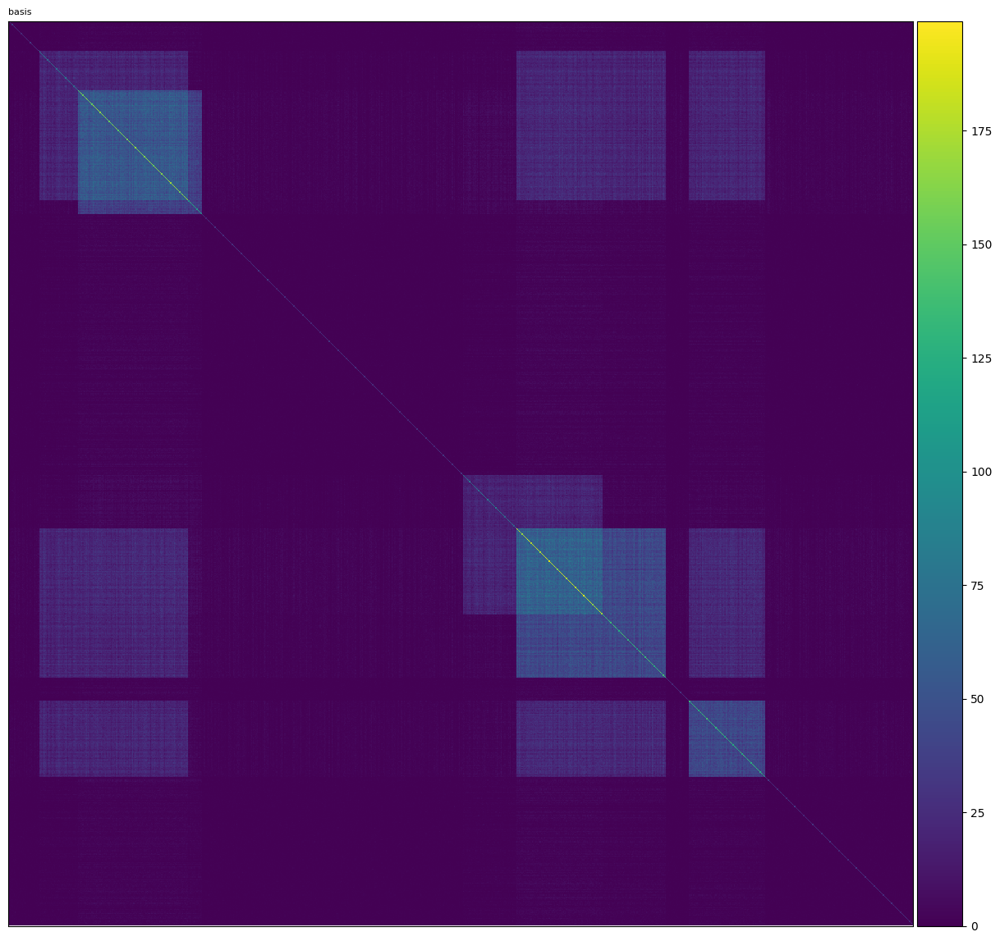

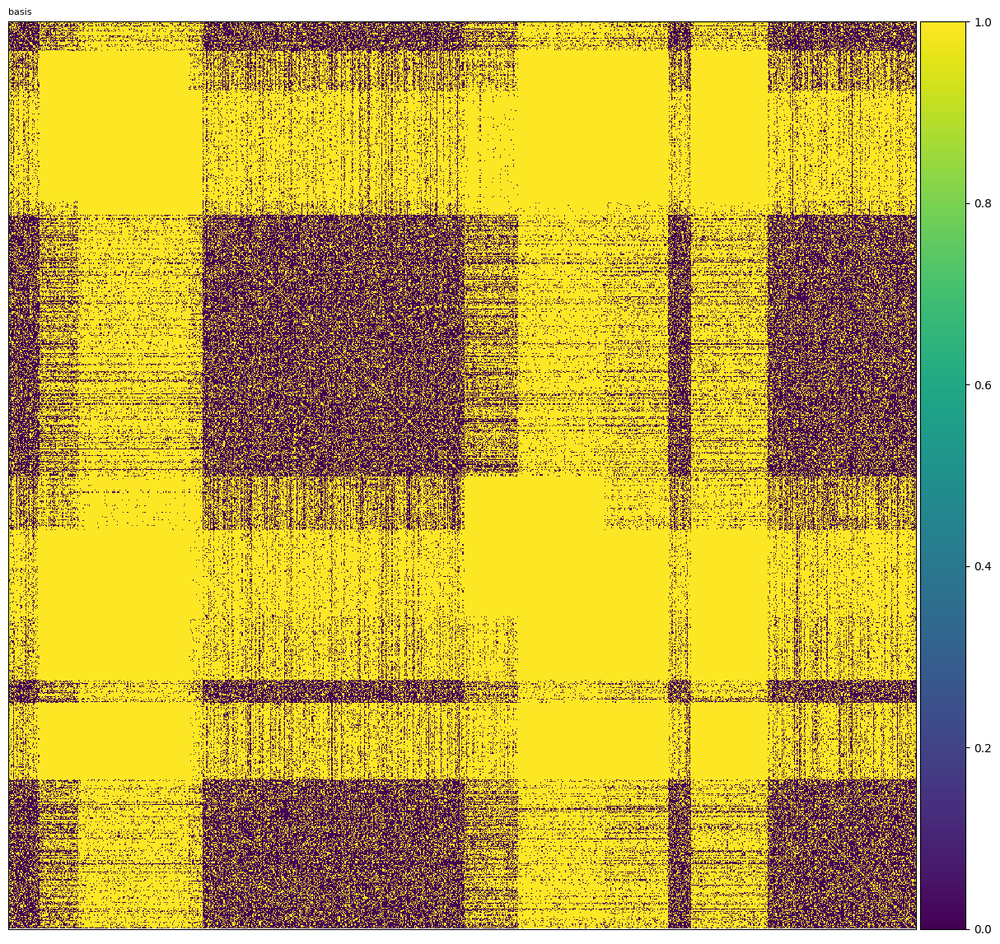

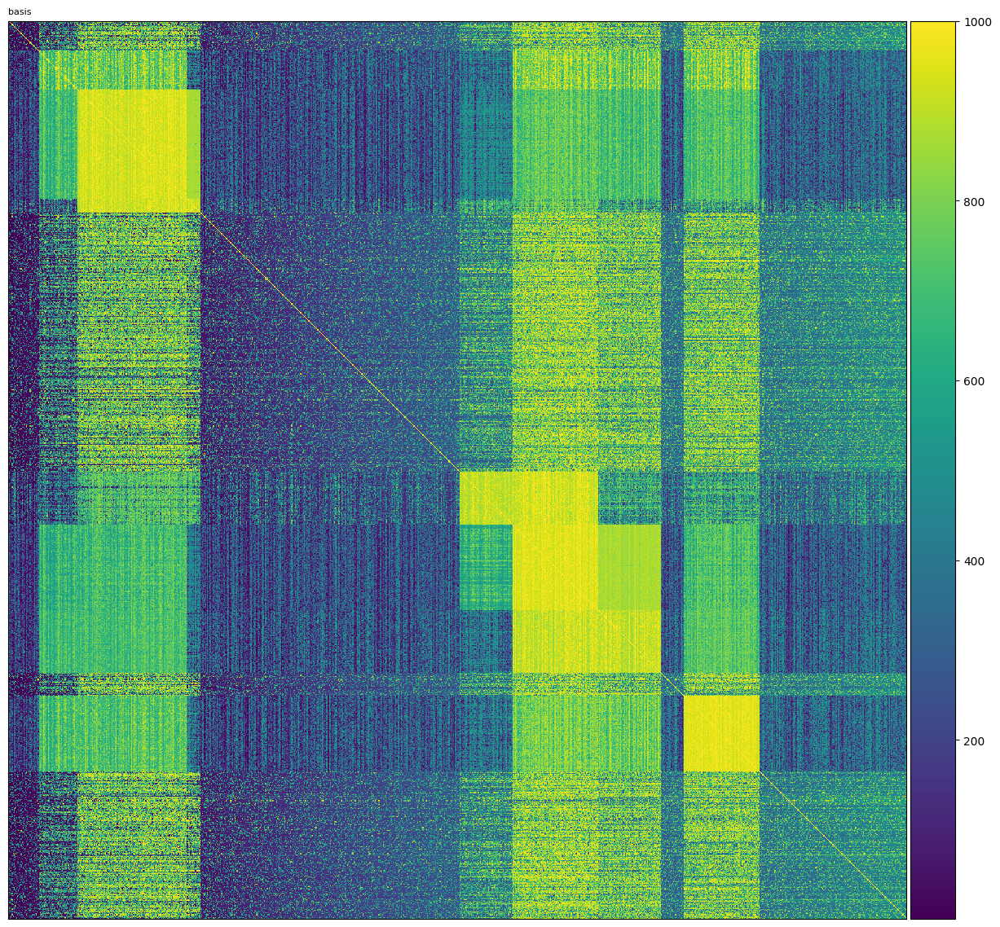

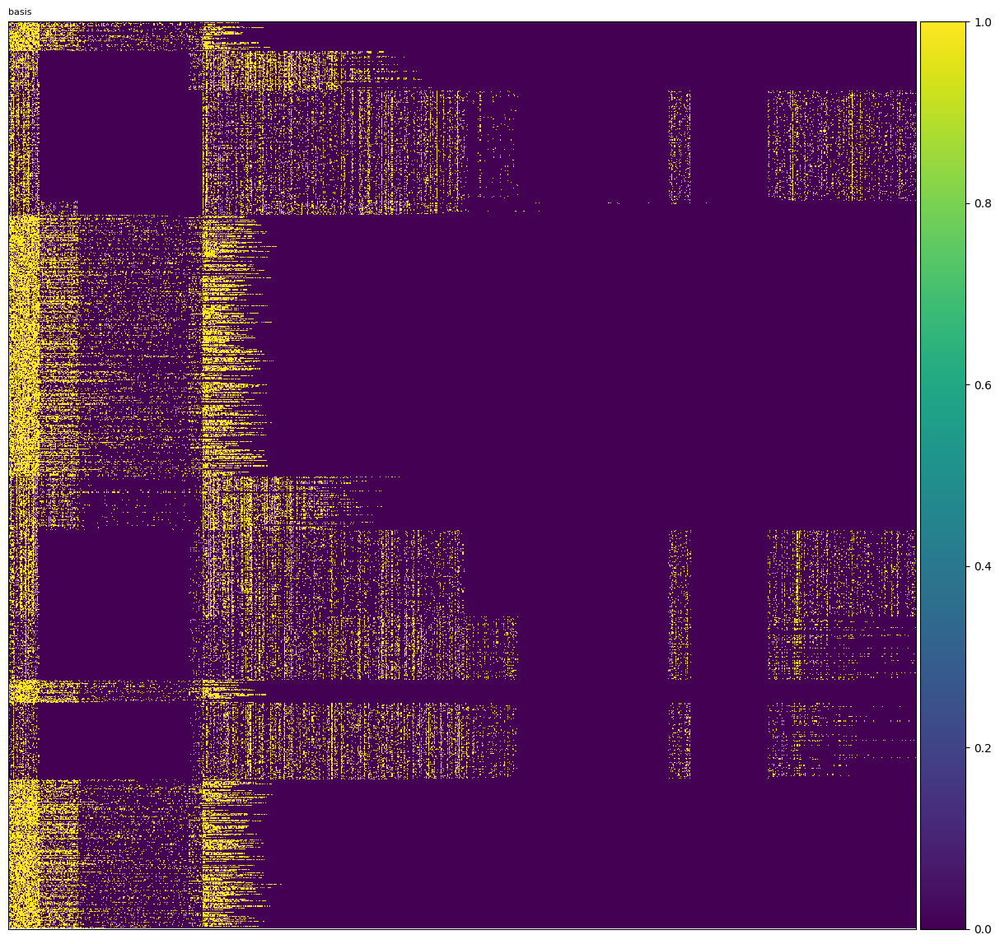

In [54]:
from utils import show_matrix, check_sparse

settings = [(check_sparse(asso.assoc, sparse=False), [0, 0], 'basis')]
show_matrix(settings=settings, colorbar=True)

settings = [(check_sparse(asso.assoc > 0.9, sparse=False), [0, 0], 'basis')]
show_matrix(settings=settings, colorbar=True)

settings = [(check_sparse(asso.basis, sparse=False), [0, 0], 'basis')]
show_matrix(settings=settings, colorbar=True)

settings = [(check_sparse(asso.basis < 80, sparse=False), [0, 0], 'basis')]
show_matrix(settings=settings, colorbar=True)


In [42]:
from scipy.stats import rankdata
from scipy.sparse import csr_matrix
import numpy as np

a = csr_matrix(np.array([[0, 1, 2], [0, 1, 2]]))

rankdata(-a.toarray(), method='ordinal', axis=1)

array([[3, 2, 1],
       [3, 2, 1]], dtype=int64)